In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import (Conv2D, MaxPooling2D, Flatten,
                                     Dense, Dropout, BatchNormalization)
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam
from tensorflow import keras

In [ ]:
import kagglehub



# Download Food-101 dataset
path = kagglehub.dataset_download("dansbecker/food-101")

print("Food-101 dataset downloaded and extracted!")
print("Path to dataset files:", path)

100%|██████████| 9.38G/9.38G [00:59<00:00, 168MB/s]

Extracting files...


Food-101 dataset downloaded and extracted!
Path to dataset files: /root/.cache/kagglehub/datasets/dansbecker/food-101/versions/1


In [ ]:
import os
import shutil

def organize_food101(data_dir):
    with open(os.path.join(data_dir, 'meta', 'train.txt')) as f:
        train_files = f.read().splitlines()
    with open(os.path.join(data_dir, 'meta', 'test.txt')) as f:
        test_files = f.read().splitlines()

    os.makedirs(os.path.join(data_dir, 'train'), exist_ok=True)
    os.makedirs(os.path.join(data_dir, 'test'), exist_ok=True)

    for split, files in [('train', train_files), ('test', test_files)]:
        for file in files:
            src = os.path.join(data_dir, 'images', file + '.jpg')
            dst_dir = os.path.join(data_dir, split, file.split('/')[0])
            os.makedirs(dst_dir, exist_ok=True)
            shutil.copy(src, dst_dir)

organize_food101("/root/.cache/kagglehub/datasets/dansbecker/food-101/versions/1/food-101/food-101")


In [ ]:
from torchvision import datasets, transforms
from torch.utils.data import DataLoader

train_data_generator = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest',
    validation_split=0.2
)
valid_datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.2
)
test_data_generator = ImageDataGenerator(
    rescale=1./255,
)

train_gen = train_data_generator.flow_from_directory(
    "/root/.cache/kagglehub/datasets/dansbecker/food-101/versions/1/food-101/food-101/train",
    target_size=(256, 256),
    batch_size=32,
    class_mode='categorical',
    subset='training',
)
valid_gen = valid_datagen.flow_from_directory(
    "/root/.cache/kagglehub/datasets/dansbecker/food-101/versions/1/food-101/food-101/train",
    target_size=(256, 256),
    batch_size=32,
    class_mode='categorical',
    subset='validation'
)

test_gen = test_data_generator.flow_from_directory(
    '/root/.cache/kagglehub/datasets/dansbecker/food-101/versions/1/food-101/food-101/test',
    target_size=(256, 256),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)




Found 60600 images belonging to 101 classes.
Found 15150 images belonging to 101 classes.
Found 25250 images belonging to 101 classes.


In [ ]:
BATCH_SIZE = 32
IMG_HEIGHT = 256
IMG_WIDTH = 256



Class Names: ['apple_pie', 'baby_back_ribs', 'baklava', 'beef_carpaccio', 'beef_tartare', 'beet_salad', 'beignets', 'bibimbap', 'bread_pudding', 'breakfast_burrito', 'bruschetta', 'caesar_salad', 'cannoli', 'caprese_salad', 'carrot_cake', 'ceviche', 'cheese_plate', 'cheesecake', 'chicken_curry', 'chicken_quesadilla', 'chicken_wings', 'chocolate_cake', 'chocolate_mousse', 'churros', 'clam_chowder', 'club_sandwich', 'crab_cakes', 'creme_brulee', 'croque_madame', 'cup_cakes', 'deviled_eggs', 'donuts', 'dumplings', 'edamame', 'eggs_benedict', 'escargots', 'falafel', 'filet_mignon', 'fish_and_chips', 'foie_gras', 'french_fries', 'french_onion_soup', 'french_toast', 'fried_calamari', 'fried_rice', 'frozen_yogurt', 'garlic_bread', 'gnocchi', 'greek_salad', 'grilled_cheese_sandwich', 'grilled_salmon', 'guacamole', 'gyoza', 'hamburger', 'hot_and_sour_soup', 'hot_dog', 'huevos_rancheros', 'hummus', 'ice_cream', 'lasagna', 'lobster_bisque', 'lobster_roll_sandwich', 'macaroni_and_cheese', 'macaron

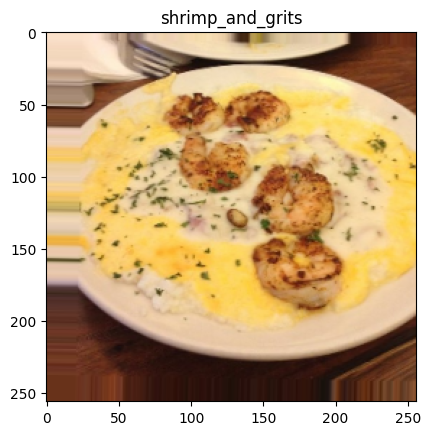

1


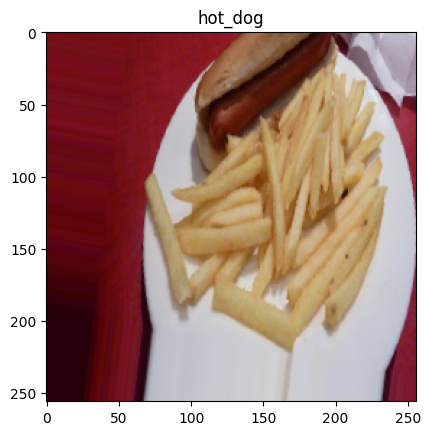

2


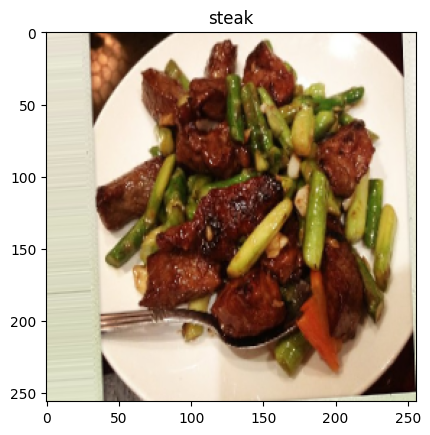

3


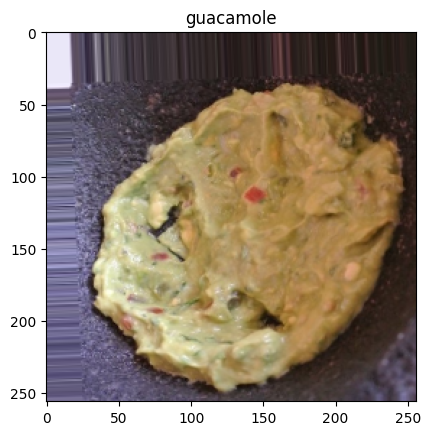

4


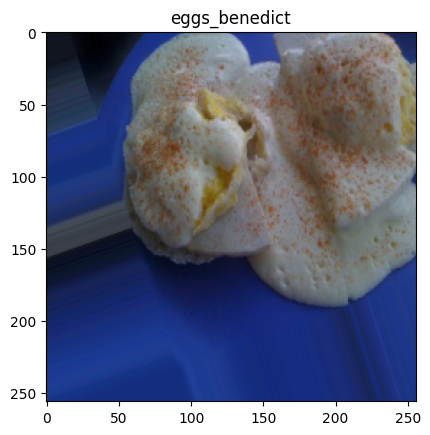

5


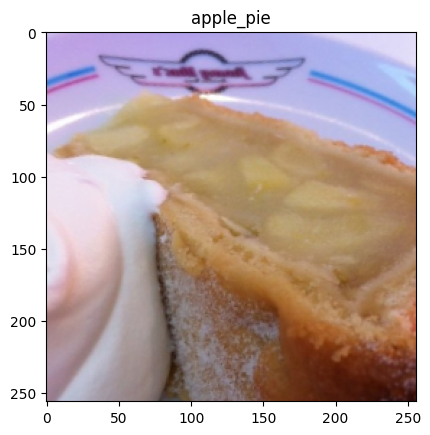

6


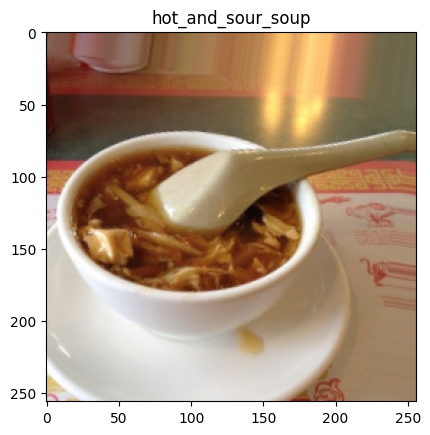

7


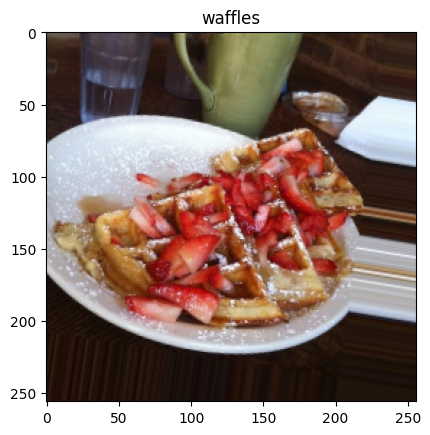

8


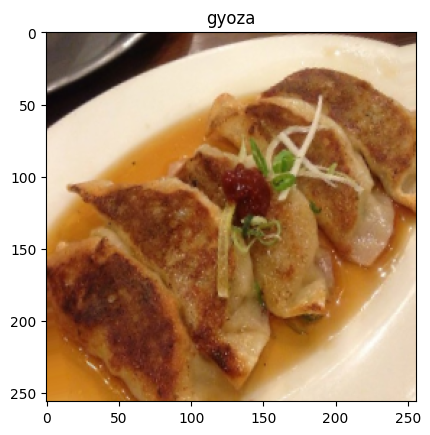

9


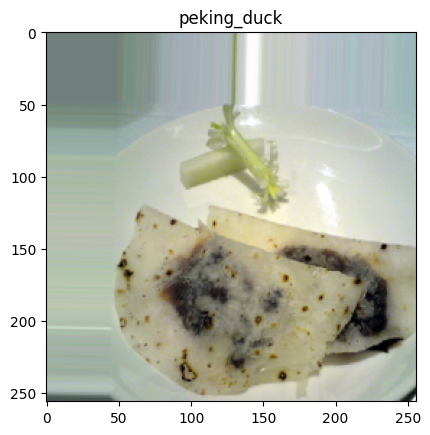

10


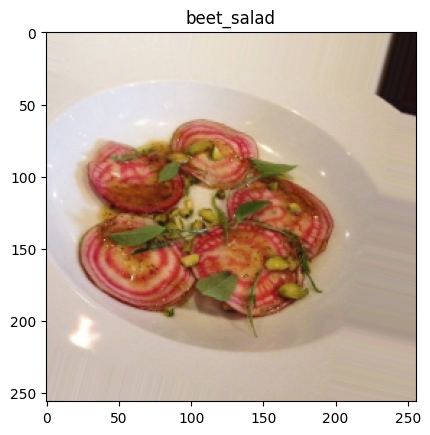

11


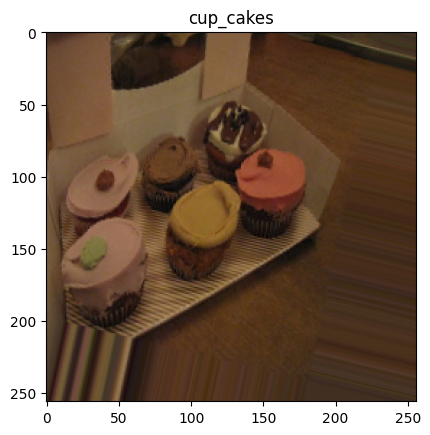

12


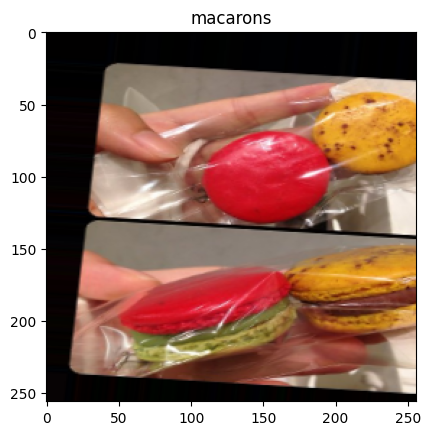

13


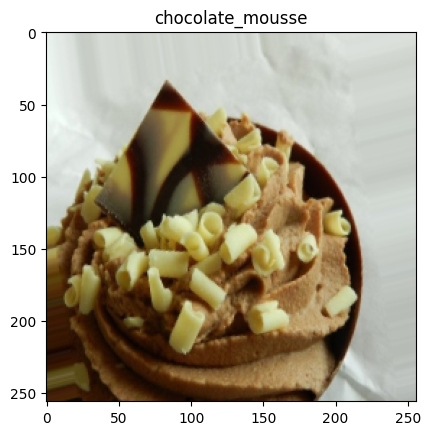

14


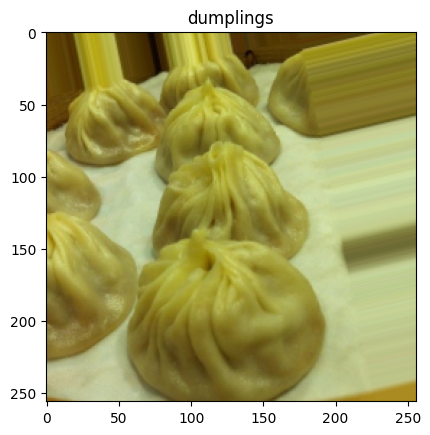

15


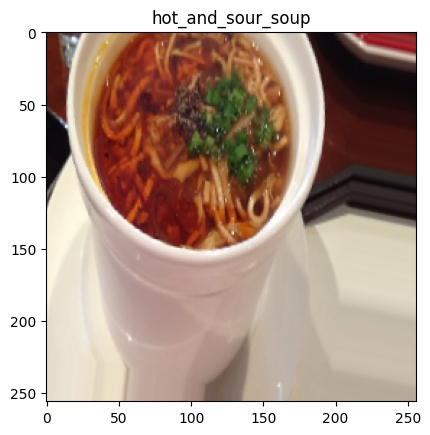

16


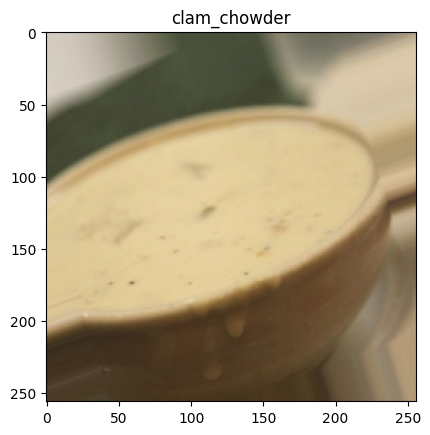

17


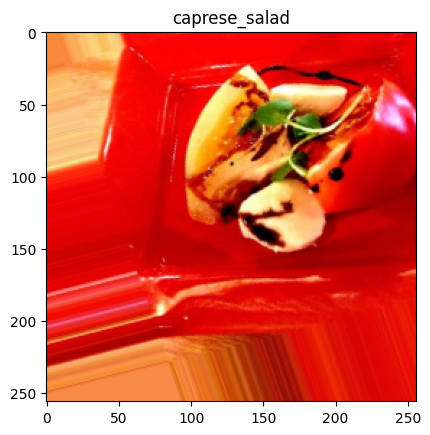

18


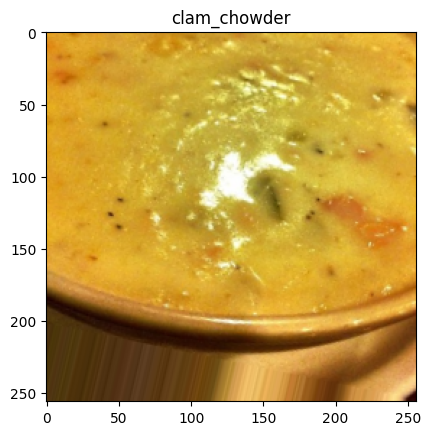

19


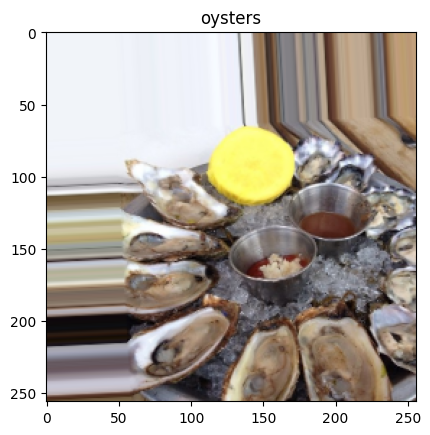

20


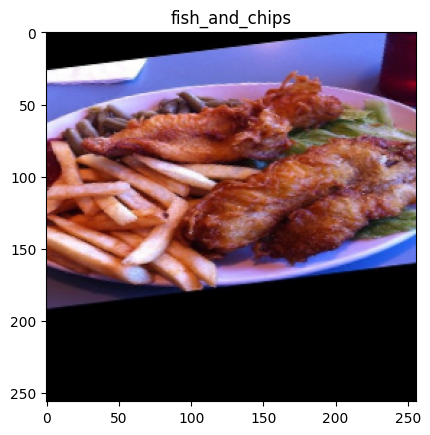

21


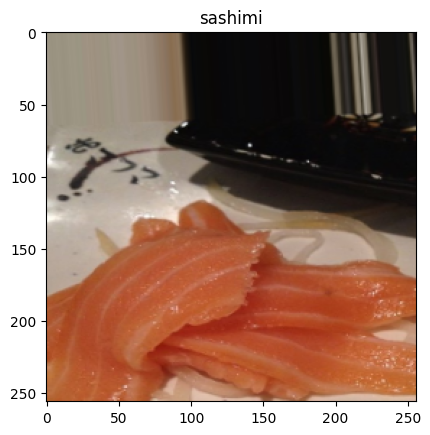

22


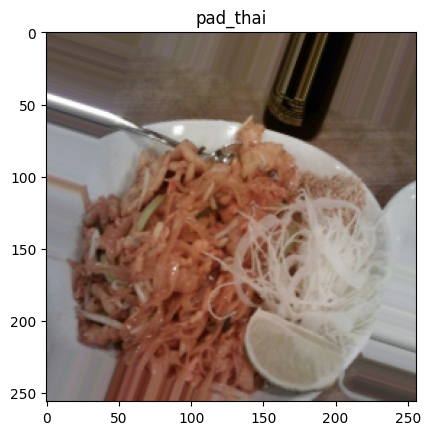

23


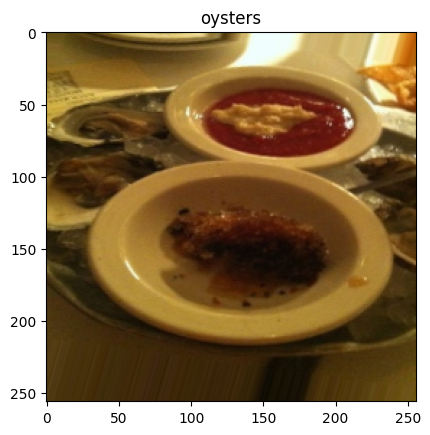

24


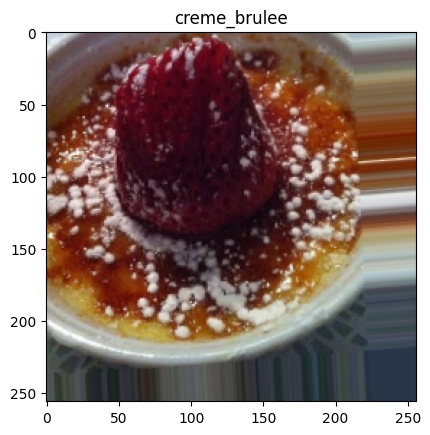

25


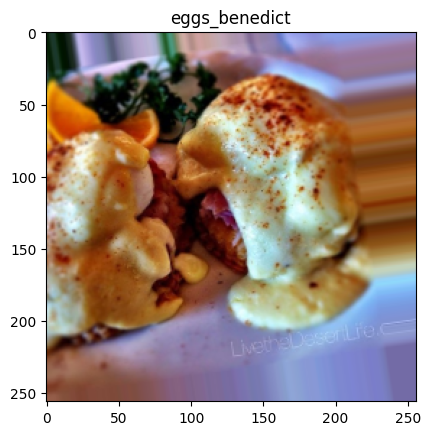

26


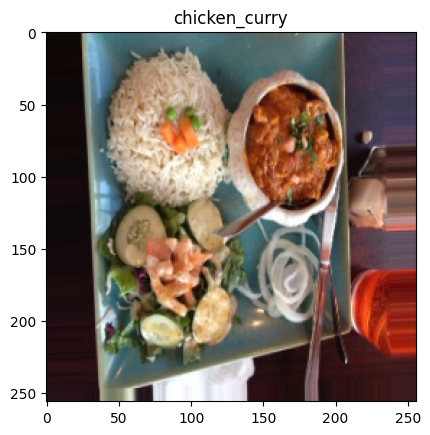

27


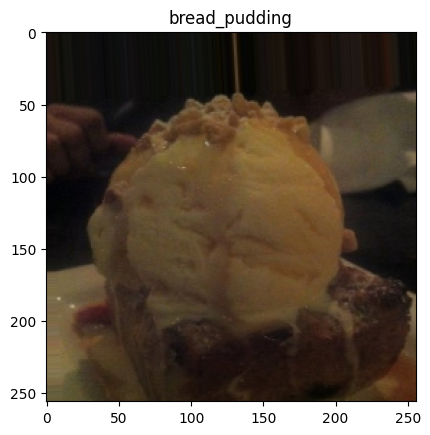

28


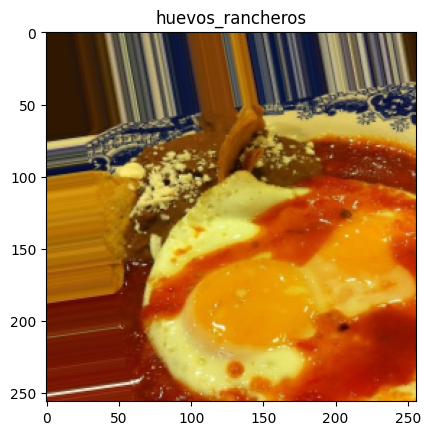

29


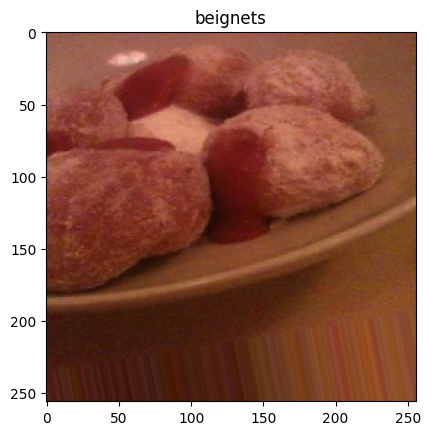

30


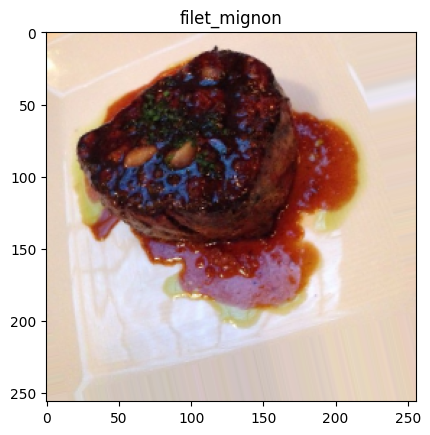

31


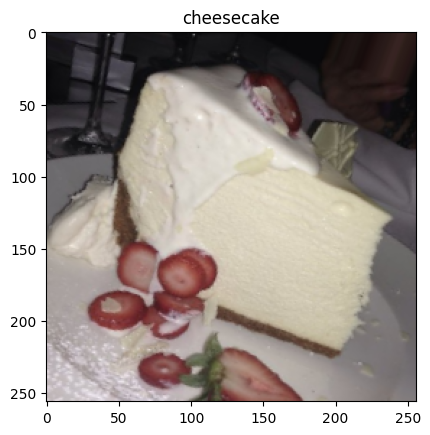

32


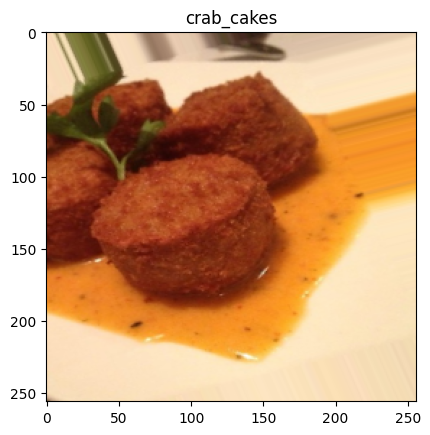

33


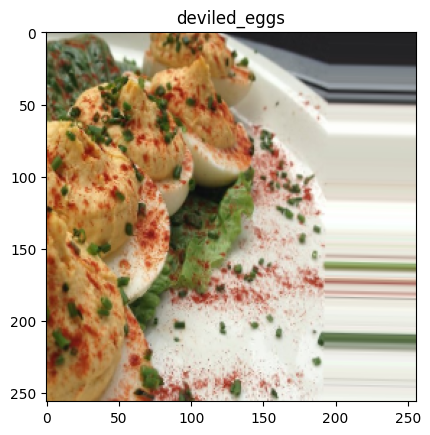

34


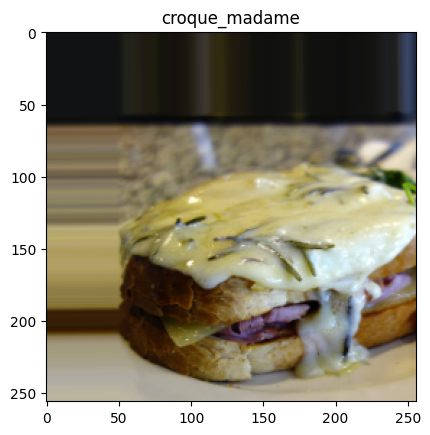

35


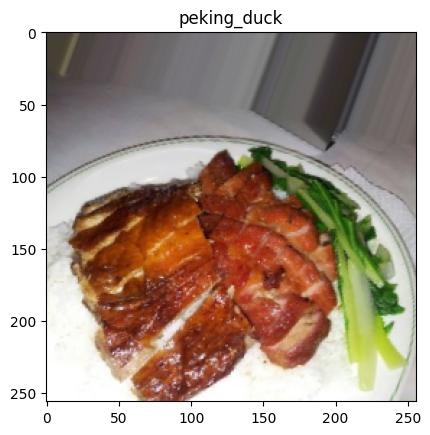

36


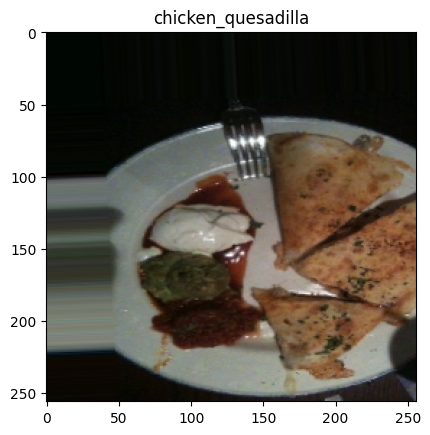

37


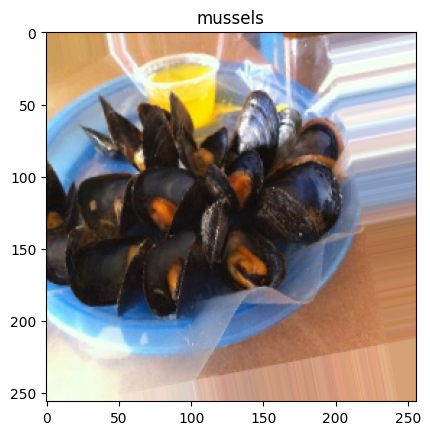

38


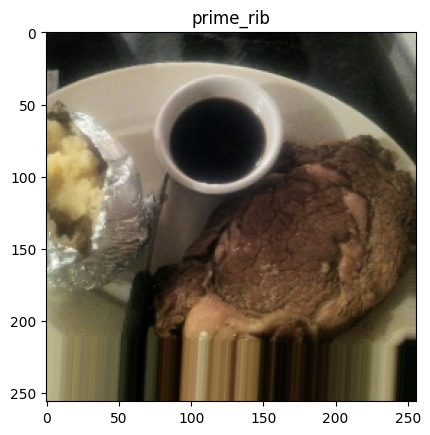

39


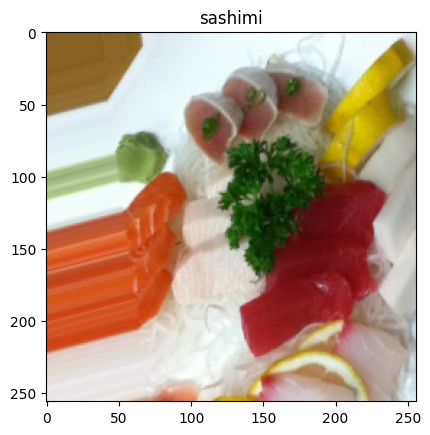

40


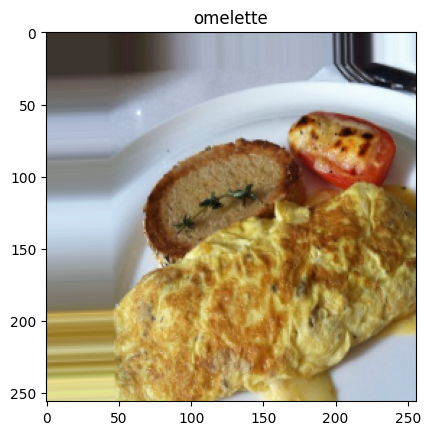

41


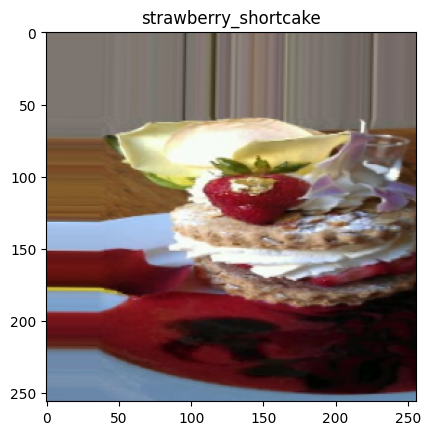

42


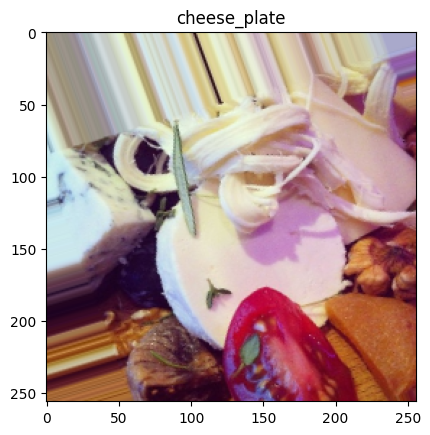

43


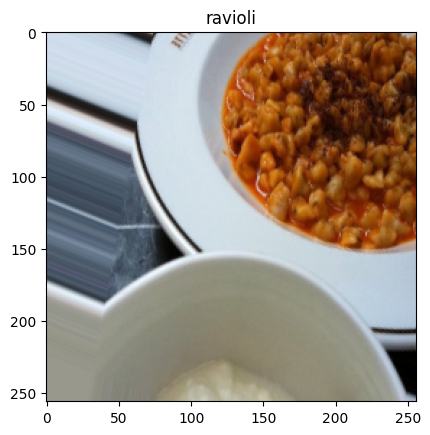

44


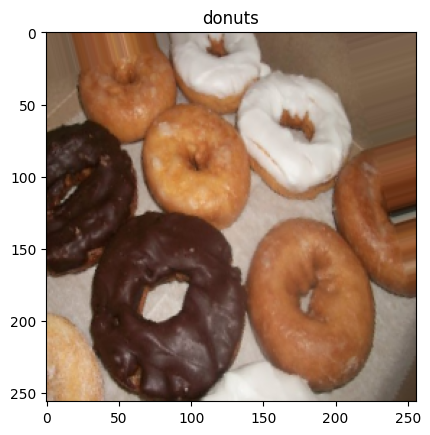

45


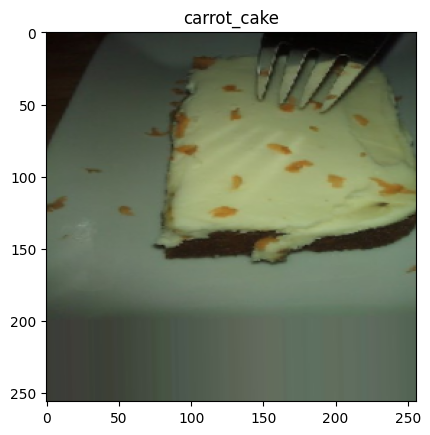

46


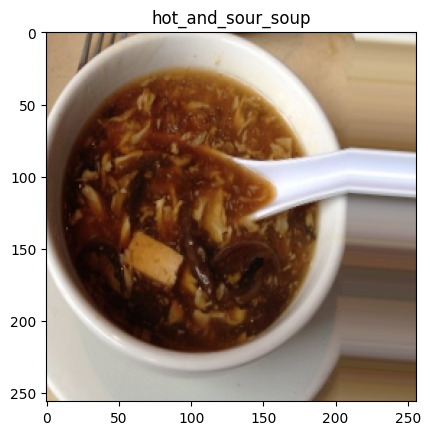

47


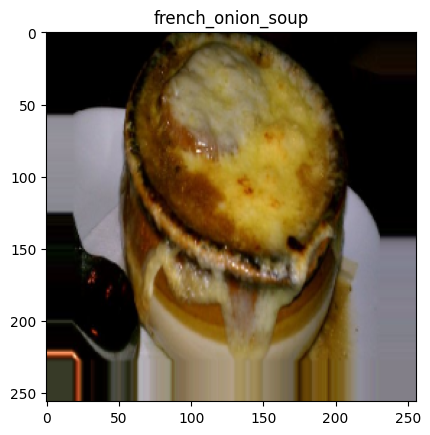

48


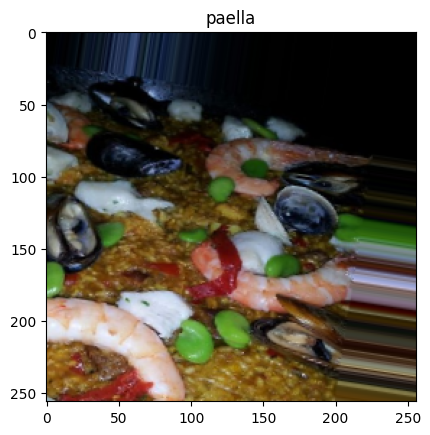

49


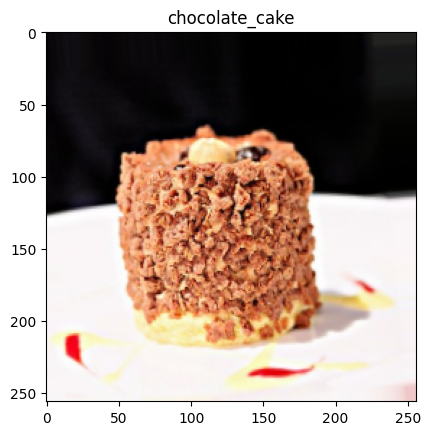

50


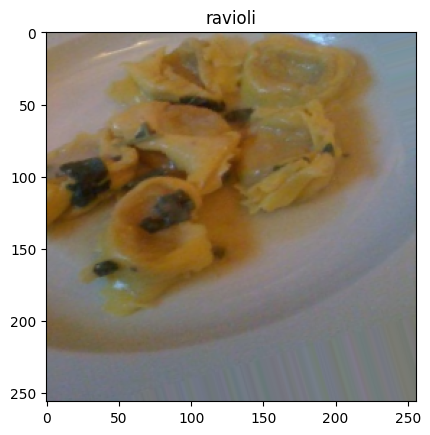

51


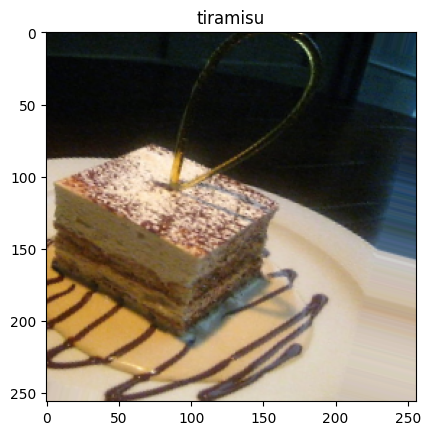

52


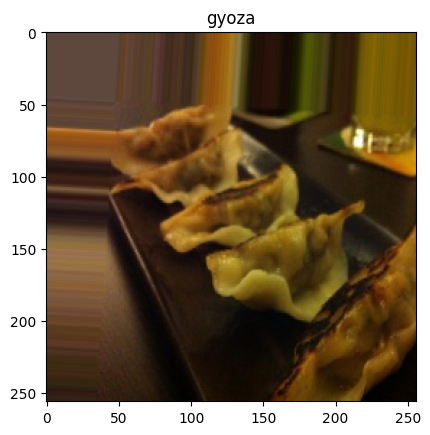

53


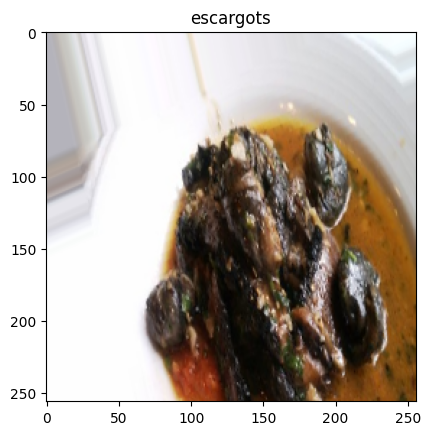

54


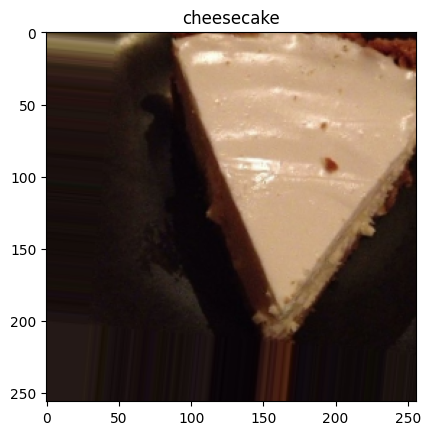

55


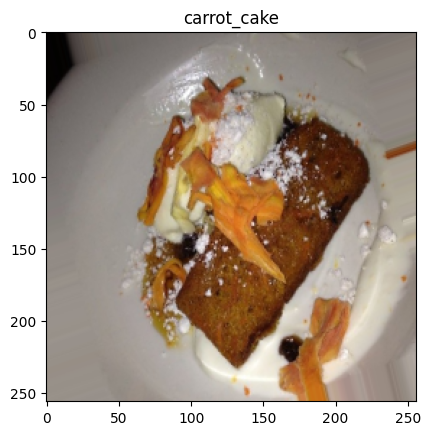

56


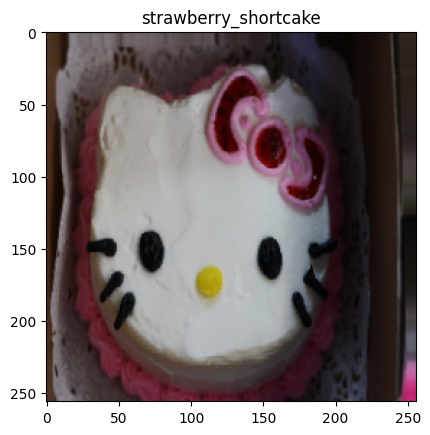

57


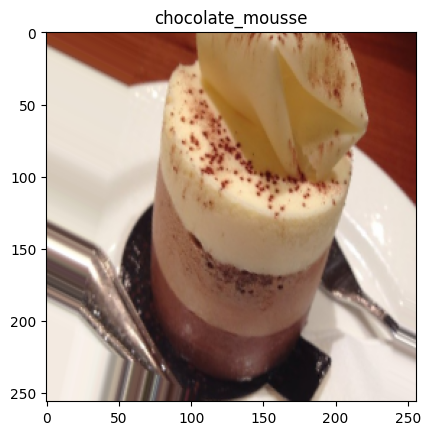

58


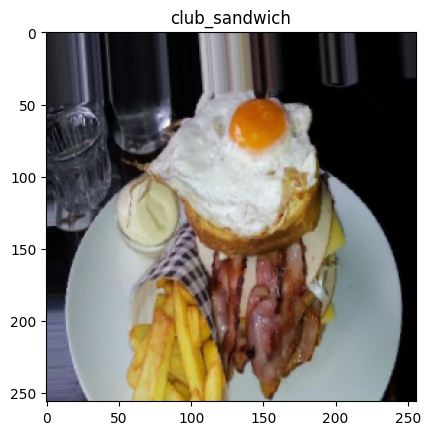

59


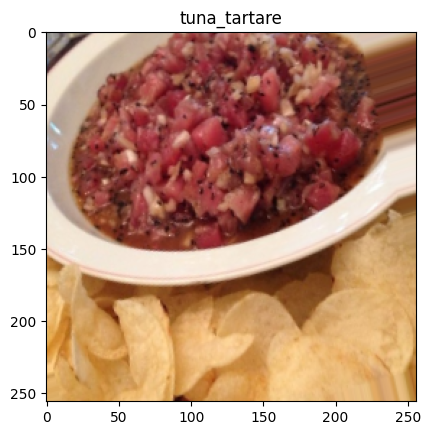

60


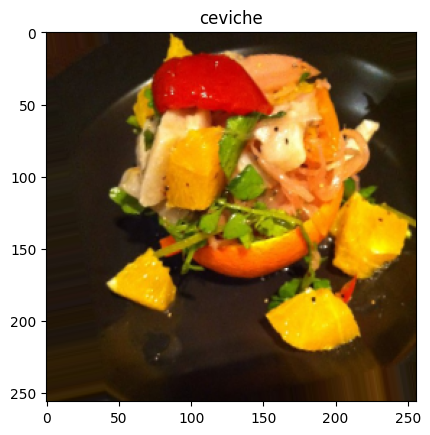

61


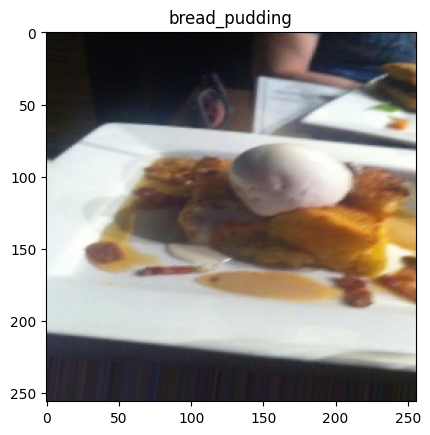

62


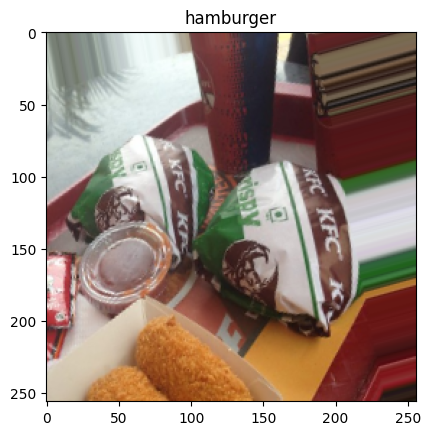

63


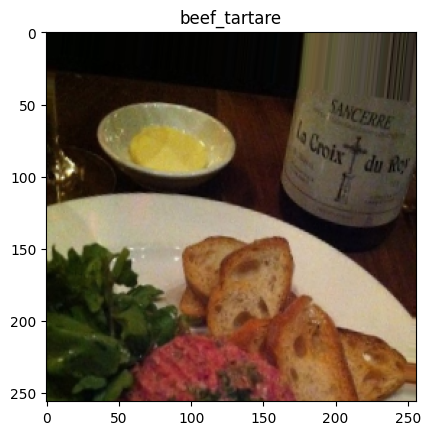

64


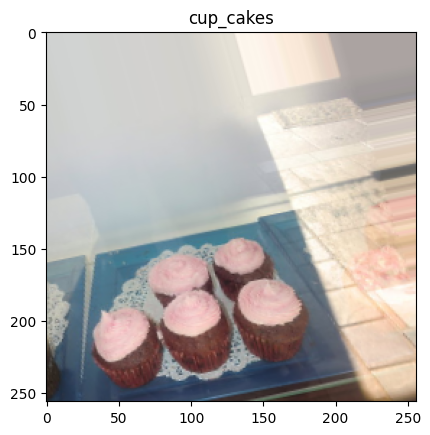

65


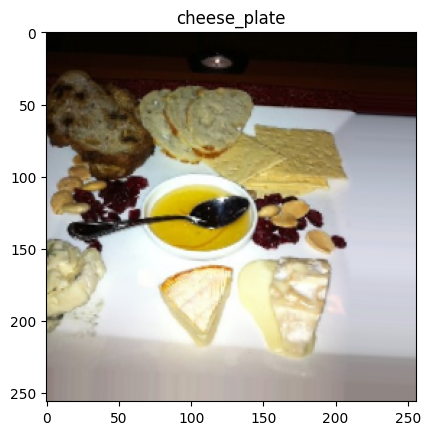

66


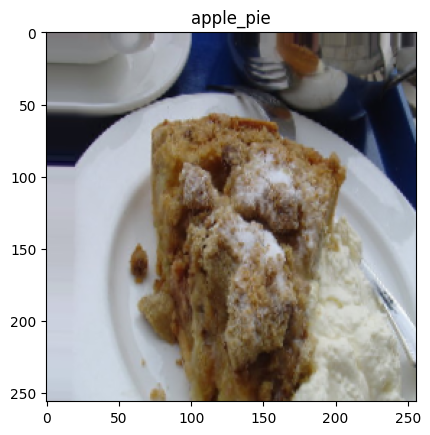

67


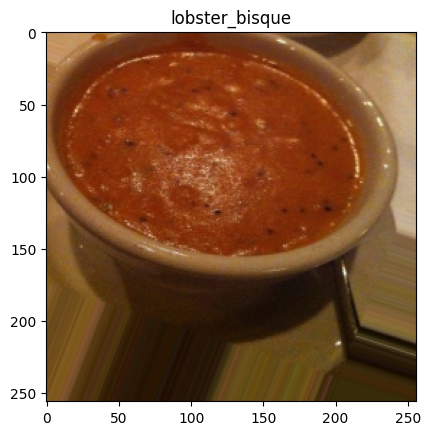

68


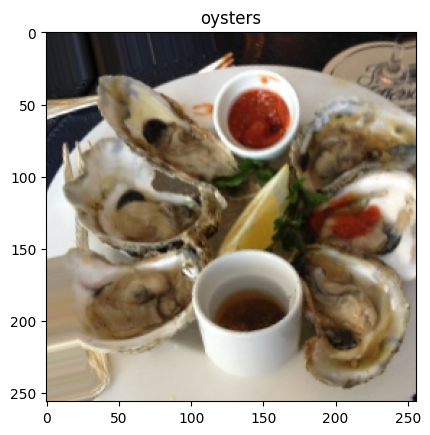

69


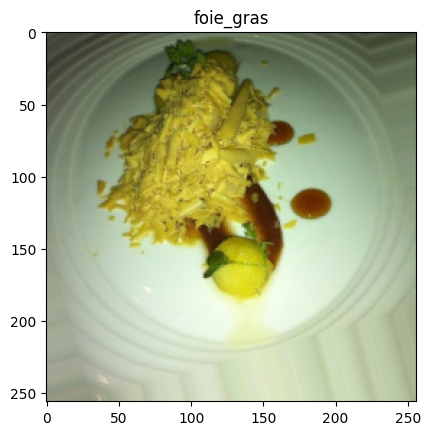

70


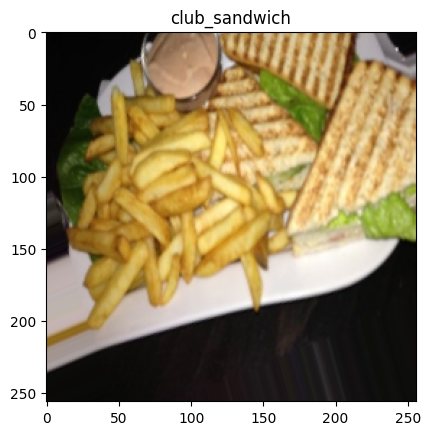

71


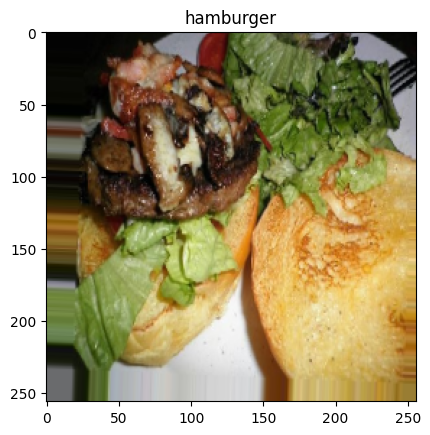

72


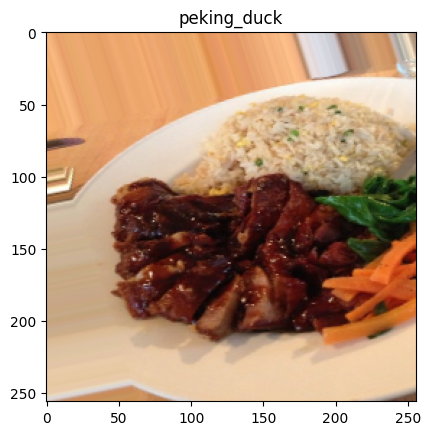

73


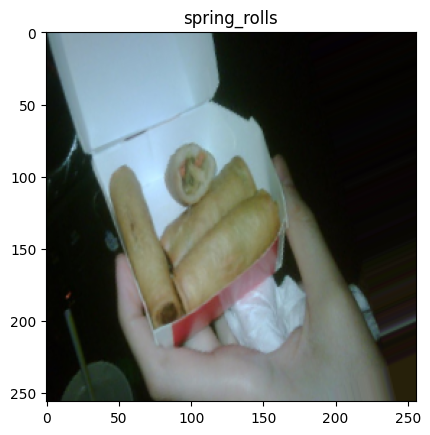

74


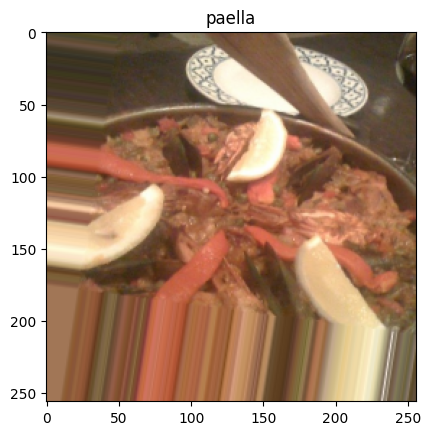

75


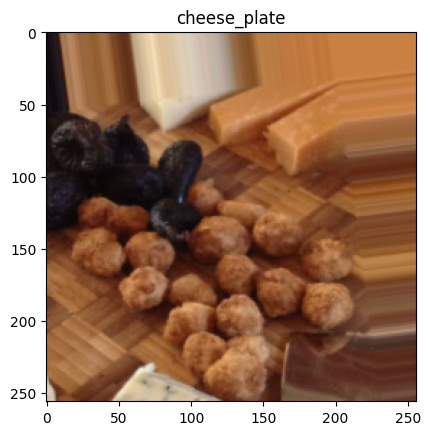

76


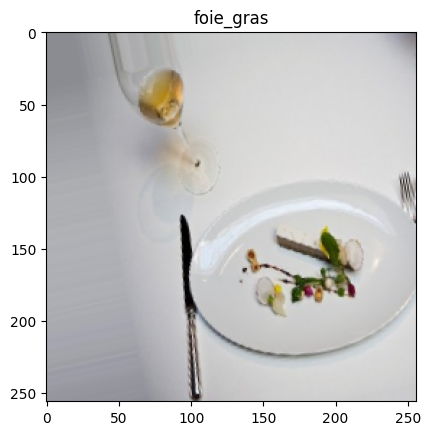

77


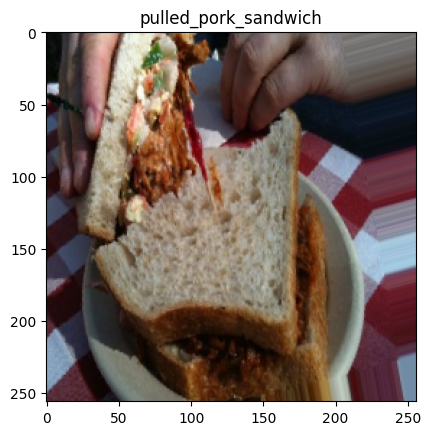

78


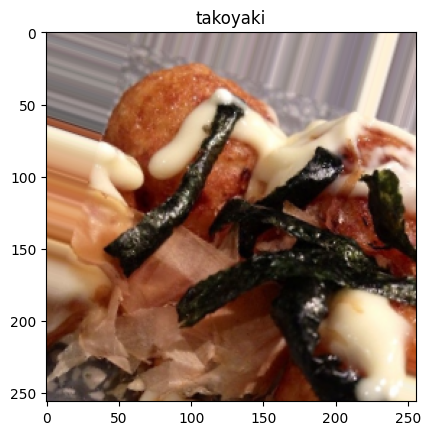

79


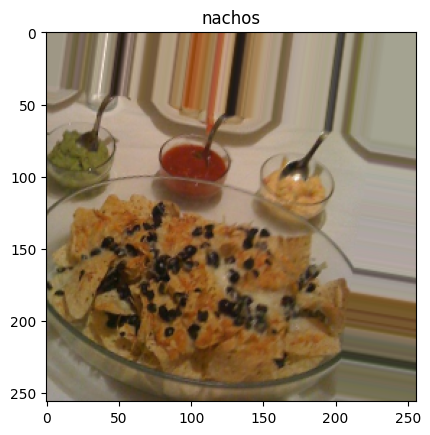

80


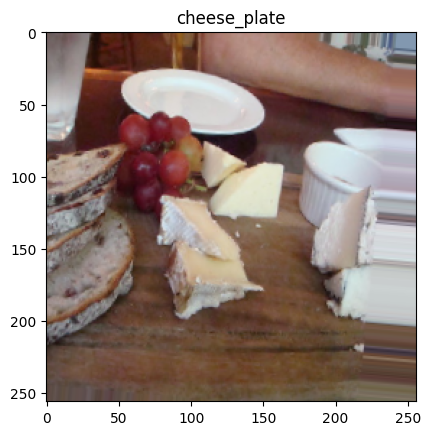

81


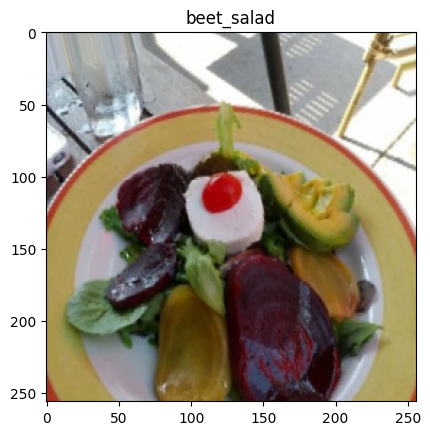

82


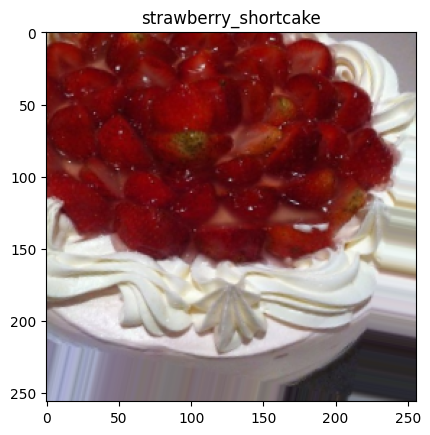

83


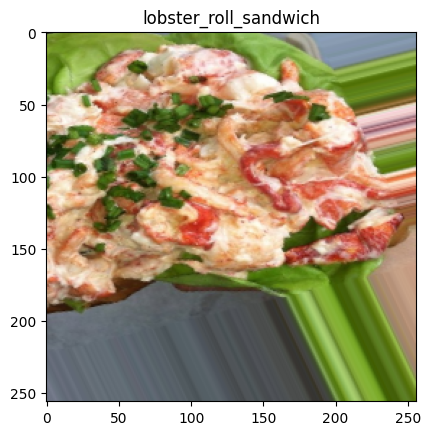

84


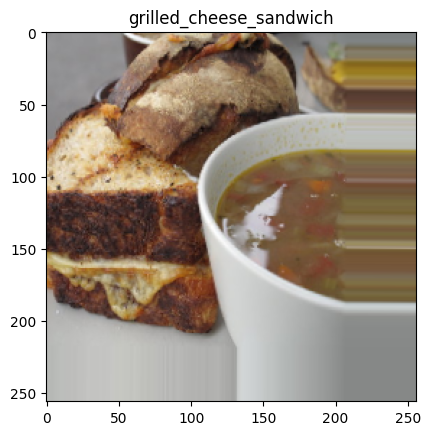

85


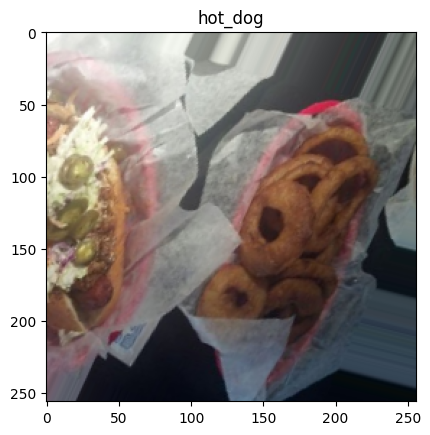

86


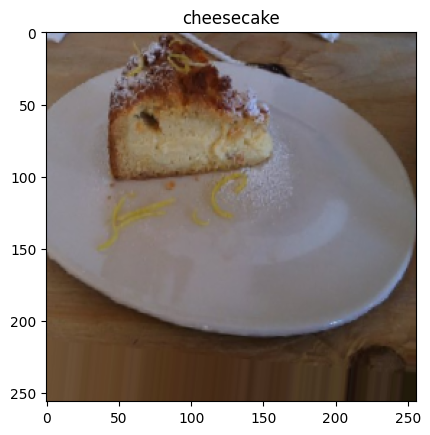

87


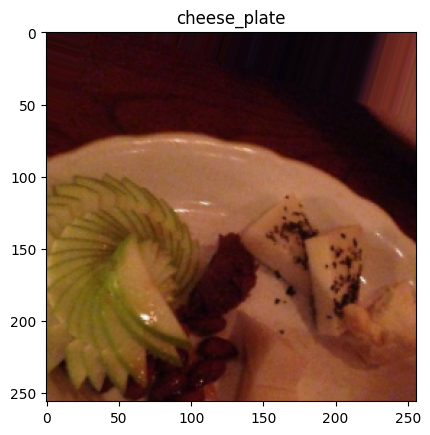

88


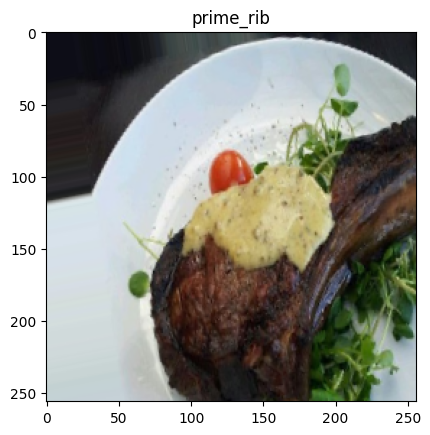

89


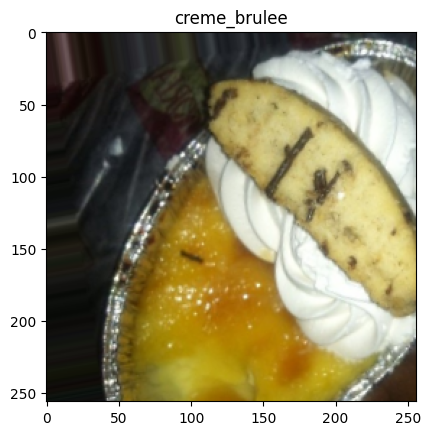

90


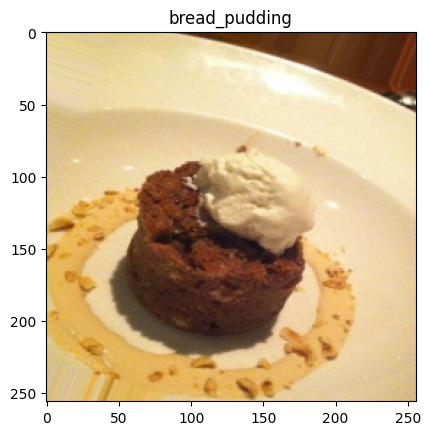

91


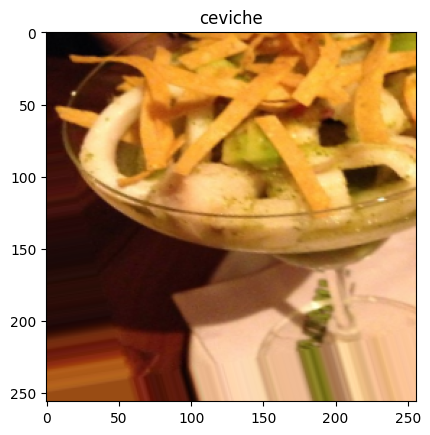

92


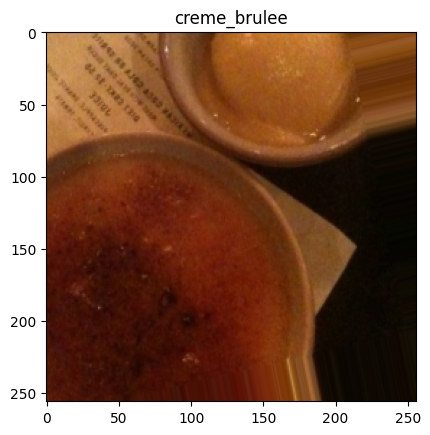

93


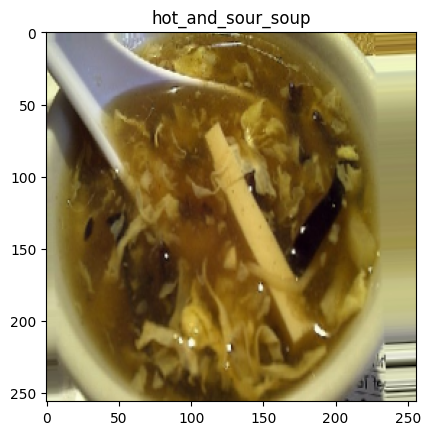

94


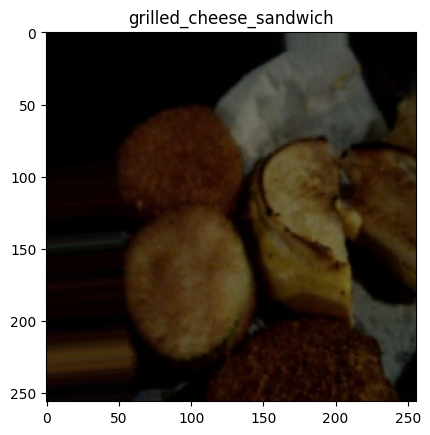

95


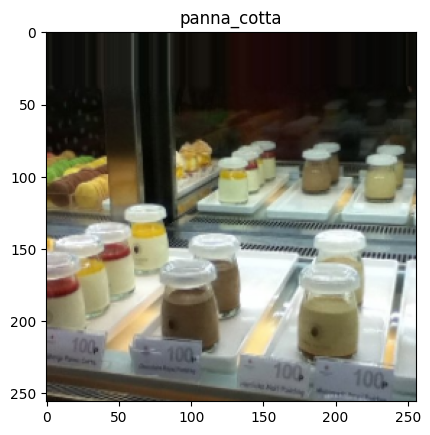

96


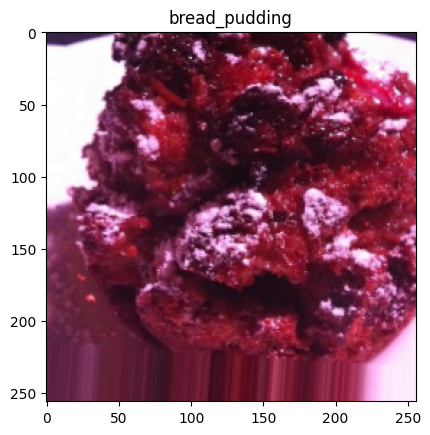

97


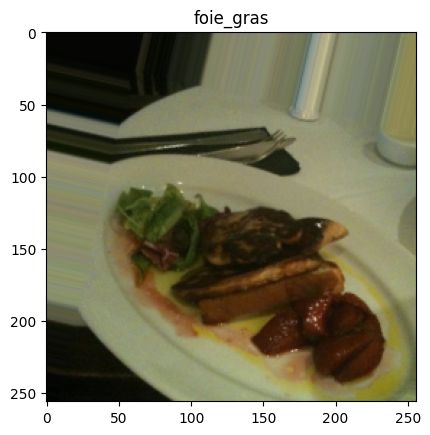

98


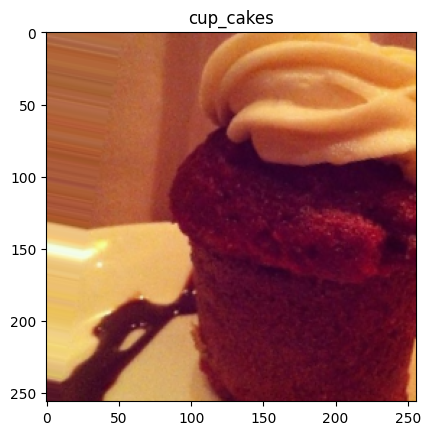

99


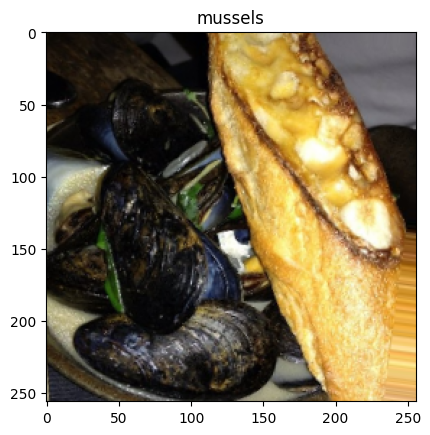

100


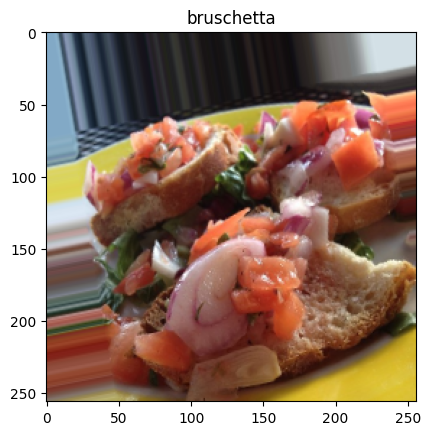

101


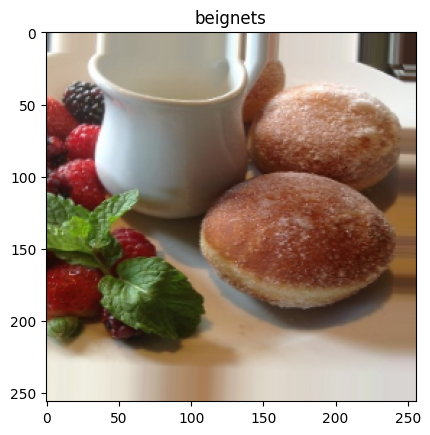

102


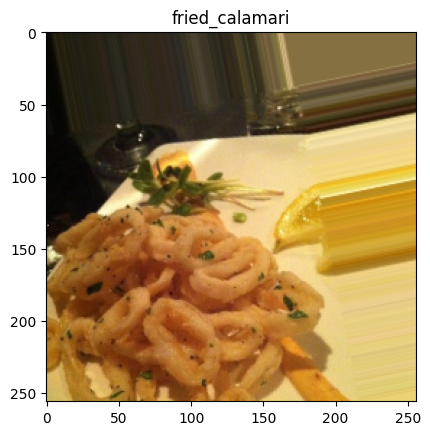

103


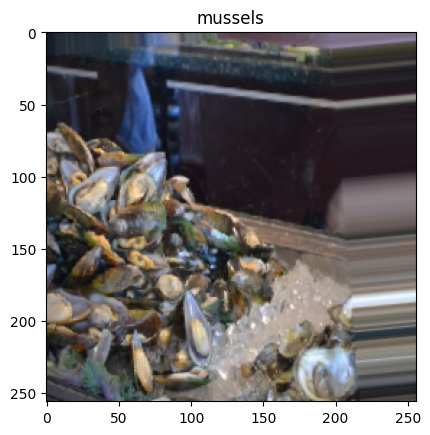

104


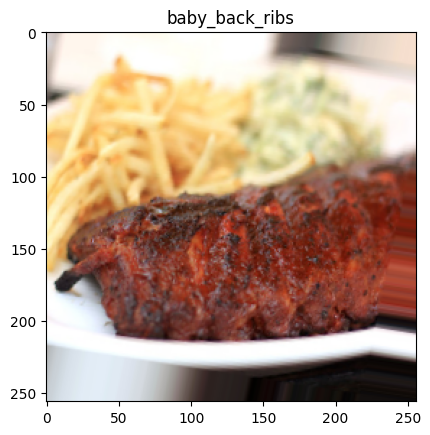

105


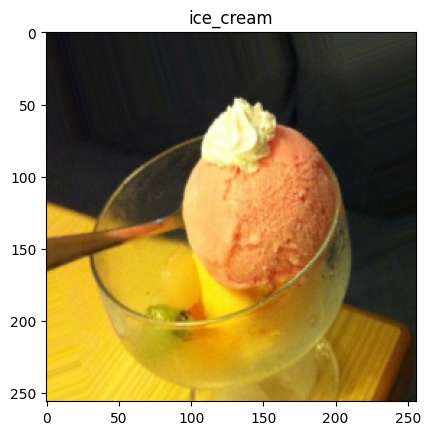

106


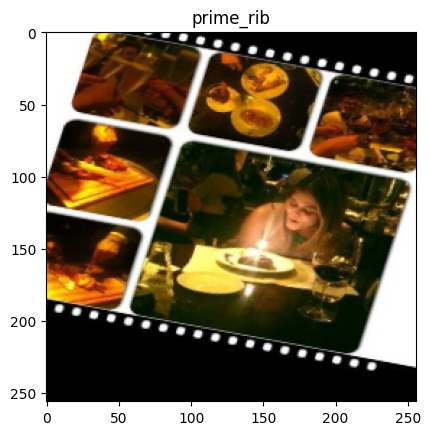

107


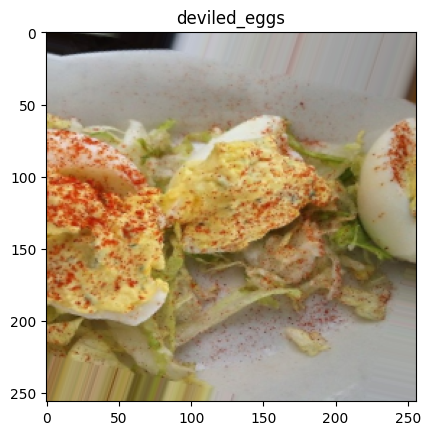

108


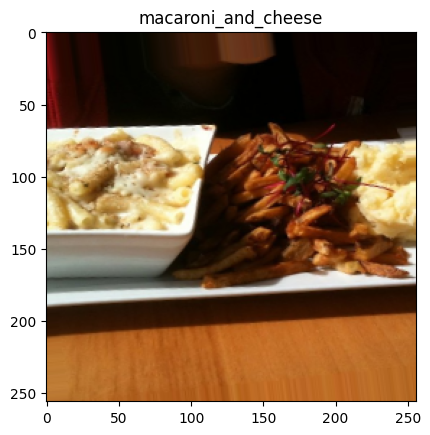

109


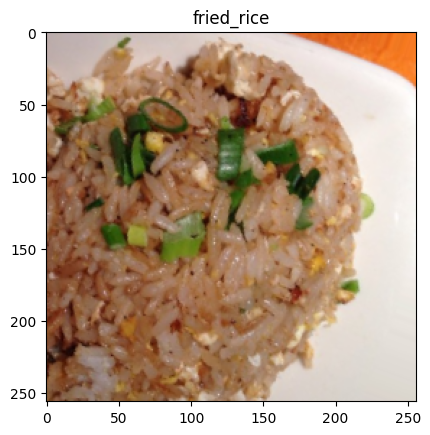

110


<Figure size 640x480 with 0 Axes>

In [ ]:
class_names = list(train_gen.class_indices.keys())
print("Class Names:", class_names)
n_rows = 10
n_cols = 11
x = 0
#printing out some images
for images, labels in train_gen:
    for i in range(images.shape[0]):
        plt.imshow(images[i])
        class_index = np.argmax(labels[i])
        plt.title(class_names[class_index])
        plt.show()
        x += 1
        print(x)
        if x >= n_rows * n_cols:
            break
    if x >= n_rows * n_cols:
        break

plt.subplots_adjust(wspace=.2, hspace=.2)

In [ ]:
# Get the number of classes
num_classes = len(train_gen.class_indices)
print(f"Number of classes: {num_classes}")
tf.random.set_seed(42)
np.random.seed(42)

resnet50 = keras.applications.resnet50.ResNet50(
    weights="imagenet", include_top=False, input_shape=(IMG_HEIGHT, IMG_WIDTH, 3)
)
x = keras.layers.GlobalAveragePooling2D()(resnet50.output)
predictions = keras.layers.Dense(num_classes, activation="softmax")(x)
model = keras.models.Model(inputs=resnet50.input, outputs=predictions)
# model.summary()



Number of classes: 101


In [ ]:
from google.colab import files
steps_per_epoch = len(train_gen) // 4
validation_steps = len(valid_gen) // 4
optimizer = keras.optimizers.Adam(learning_rate=.0001)
model.compile(optimizer=optimizer, loss="categorical_crossentropy", metrics=["accuracy"])


history = model.fit(
    train_gen,
    validation_data=valid_gen,
    steps_per_epoch=steps_per_epoch,
    validation_steps=validation_steps,
    epochs=25,
)
model.save('food_classification_model.h5')

# Download the model
files.download('food_classification_model.h5')


Epoch 1/25
473/473 ━━━━━━━━━━━━━━━━━━━━ 308s 544ms/step - accuracy: 0.2223 - loss: 3.5342 - val_accuracy: 0.0215 - val_loss: 4.7160
Epoch 2/25
473/473 ━━━━━━━━━━━━━━━━━━━━ 223s 472ms/step - accuracy: 0.5260 - loss: 1.8837 - val_accuracy: 0.4703 - val_loss: 2.2263
Epoch 3/25
473/473 ━━━━━━━━━━━━━━━━━━━━ 221s 469ms/step - accuracy: 0.5956 - loss: 1.5650 - val_accuracy: 0.5575 - val_loss: 1.8282
Epoch 4/25
473/473 ━━━━━━━━━━━━━━━━━━━━ 215s 455ms/step - accuracy: 0.6413 - loss: 1.3810 - val_accuracy: 0.5826 - val_loss: 1.7276
Epoch 5/25
  2/473 ━━━━━━━━━━━━━━━━━━━━ 31s 67ms/step - accuracy: 0.6484 - loss: 0.9769

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


473/473 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - accuracy: 0.6718 - loss: 1.0523 - val_accuracy: 0.6739 - val_loss: 1.3762
Epoch 6/25
473/473 ━━━━━━━━━━━━━━━━━━━━ 230s 479ms/step - accuracy: 0.6538 - loss: 1.2982 - val_accuracy: 0.6078 - val_loss: 1.5955
Epoch 7/25
473/473 ━━━━━━━━━━━━━━━━━━━━ 225s 477ms/step - accuracy: 0.6925 - loss: 1.1700 - val_accuracy: 0.5911 - val_loss: 1.6756
Epoch 8/25
473/473 ━━━━━━━━━━━━━━━━━━━━ 224s 475ms/step - accuracy: 0.7092 - loss: 1.0994 - val_accuracy: 0.6184 - val_loss: 1.5562
Epoch 9/25
473/473 ━━━━━━━━━━━━━━━━━━━━ 220s 466ms/step - accuracy: 0.7083 - loss: 1.0840 - val_accuracy: 0.6510 - val_loss: 1.4105
Epoch 10/25
473/473 ━━━━━━━━━━━━━━━━━━━━ 0s 285us/step - accuracy: 0.7814 - loss: 0.9454 - val_accuracy: 0.5870 - val_loss: 1.5509
Epoch 11/25
473/473 ━━━━━━━━━━━━━━━━━━━━ 229s 478ms/step - accuracy: 0.7386 - loss: 0.9549 - val_accuracy: 0.6382 - val_loss: 1.5036
Epoch 12/25
473/473 ━━━━━━━━━━━━━━━━━━━━ 225s 477ms/step - accuracy: 0.7400 - loss: 0.9648

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
model.evaluate(test_gen)

  2/790 ━━━━━━━━━━━━━━━━━━━━ 1:01 77ms/step - accuracy: 0.7734 - loss: 0.8572 

/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


790/790 ━━━━━━━━━━━━━━━━━━━━ 64s 81ms/step - accuracy: 0.7163 - loss: 1.1298


[1.1317245960235596, 0.7169504761695862]

In [ ]:
model = keras.models.load_model('/content/drive/MyDrive/ML4VA/food_classification_model_69.h5')
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
y_actual = test_gen.classes
class_names = list(test_gen.class_indices.keys())

y_pred = model.predict(test_gen)
y_pred_class = np.argmax(y_pred, axis=1)
print(classification_report(y_actual, y_pred_class, target_names=class_names))

# cm = confusion_matrix(y_actual, y_pred_class)
# disp = ConfusionMatrixDisplay(confusion_matrix=cm)
# disp.plot(cmap=plt.cm.Blues)
# plt.title('Confusion Matrix - Validation Set')
# plt.show()
test_loss, test_accuracy = model.evaluate(test_gen)
print(f"Test Loss: {test_loss:.4f}")
print(f"Test Accuracy: {test_accuracy:.4f}")


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


790/790 ━━━━━━━━━━━━━━━━━━━━ 73s 83ms/step
                         precision    recall  f1-score   support

              apple_pie       0.52      0.48      0.50       250
         baby_back_ribs       0.72      0.77      0.74       250
                baklava       0.61      0.90      0.73       250
         beef_carpaccio       0.88      0.82      0.85       250
           beef_tartare       0.70      0.72      0.71       250
             beet_salad       0.80      0.52      0.63       250
               beignets       0.64      0.94      0.76       250
               bibimbap       0.90      0.81      0.85       250
          bread_pudding       0.36      0.67      0.47       250
      breakfast_burrito       0.81      0.47      0.60       250
             bruschetta       0.79      0.51      0.62       250
           caesar_salad       0.82      0.82      0.82       250
                cannoli       0.89      0.76      0.82       250
          caprese_salad       0.81      0.70  

In [ ]:
from sklearn.metrics import top_k_accuracy_score
top5_acc = top_k_accuracy_score(y_actual, y_pred, k=5)
print(f"Top-5 Accuracy: {top5_acc}")


Top-5 Accuracy: 0.9131089108910891
